In [51]:
from utils import load_results
import scanpy as sc
from anndata import AnnData

dataset = "pbmc_generalization"
deep_methods = ['saucie', 'desc', 'scvi', 'hd-md', 'hd-md_generalization']


def plot_results(method, dataset, keys, frameon=False, title=None, legend_loc='right margin'):
    if method in deep_methods and dataset == "pbmc_generalization":
        results_adata = load_results(method, dataset, 0)
    else:
        results_adata = load_results(method, dataset)
    
    set_seeds()
    sc.set_figure_params(dpi=200)
    
    sc.pp.neighbors(results_adata)
    sc.tl.umap(results_adata, random_state=42)

    study_cmap_map = study_cmaps[dataset]
    cell_cmap_map = cell_type_cmaps[dataset]
    
    if dataset == 'pbmc_generalization':
        tmp1 = results_adata[(results_adata.obs['study'] != '10x Chromium (v3)') & (results_adata.obs['study'] != 'Drop-seq')]
        tmp2 = results_adata[(results_adata.obs['study'] == '10x Chromium (v3)')]
        tmp3 = results_adata[(results_adata.obs['study'] == 'Drop-seq')]
        results_adata = AnnData.concatenate(tmp1, tmp2, tmp3)
        
    results_adata.obs["study"] = results_adata.obs["study"].astype("category")
    results_adata.obs["cell_type"] = results_adata.obs["cell_type"].astype("category")
    
    results_adata.uns["study_colors"] = [study_cmap_map[study] for study in results_adata.obs["study"].cat.categories]
    results_adata.uns["cell_type_colors"] = [cell_cmap_map[cell_type] for cell_type in
                                             results_adata.obs["cell_type"].cat.categories]

    for key in keys:
        sc.pl.umap(results_adata, color=key, frameon=frameon, legend_loc=legend_loc, title=title)

In [52]:
import matplotlib
from utils import load_data

adata = load_data("pancreas_generalization", normalized=True)

adata.obs["cell_type"] = adata.obs["cell_type"].astype("category")
adata.obs["study"] = adata.obs["study"].astype("category")

pancreas_study_cmap = matplotlib.cm.get_cmap("Dark2")
pancreas_study_cmap = [
    pancreas_study_cmap(0),
    pancreas_study_cmap(6),
    pancreas_study_cmap(4),
    pancreas_study_cmap(7),
    pancreas_study_cmap(5),
]

cell_cmap = matplotlib.cm.get_cmap("tab20")

pancreas_cell_cmap_map = {}
for i, cell_type in enumerate(adata.obs["cell_type"].unique()):
    pancreas_cell_cmap_map[cell_type] = cell_cmap(i)
    
pancreas_study_cmap_map = {}
for i, study in enumerate(adata.obs["study"].unique()):
    pancreas_study_cmap_map[study]= pancreas_study_cmap[i]
    
study_cmaps = {}
cell_type_cmaps = {}

study_cmaps["pancreas_generalization"] = pancreas_study_cmap_map
cell_type_cmaps["pancreas_generalization"] = pancreas_cell_cmap_map

adata = load_data("pbmc_generalization", normalized=True)

cell_cmap = matplotlib.cm.get_cmap("tab10_r")
pbmc_study_cmap = matplotlib.cm.get_cmap("Paired_r")

pbmc_cell_cmap_map = {}
for i, cell_type in enumerate(adata.obs["cell_type"].unique()):
    pbmc_cell_cmap_map[cell_type] = cell_cmap(i)

pbmc_study_cmap_map = {}
for i, study in enumerate(adata.obs["study"].unique()):
    pbmc_study_cmap_map[study]= pbmc_study_cmap(i)
pbmc_study_cmap_map['10x Chromium (v2) B'] = pbmc_study_cmap(11)
pbmc_study_cmap_map['Drop-seq'] = pbmc_study_cmap(10)

study_cmaps["pbmc_generalization"] = pbmc_study_cmap_map
cell_type_cmaps["pbmc_generalization"] = pbmc_cell_cmap_map

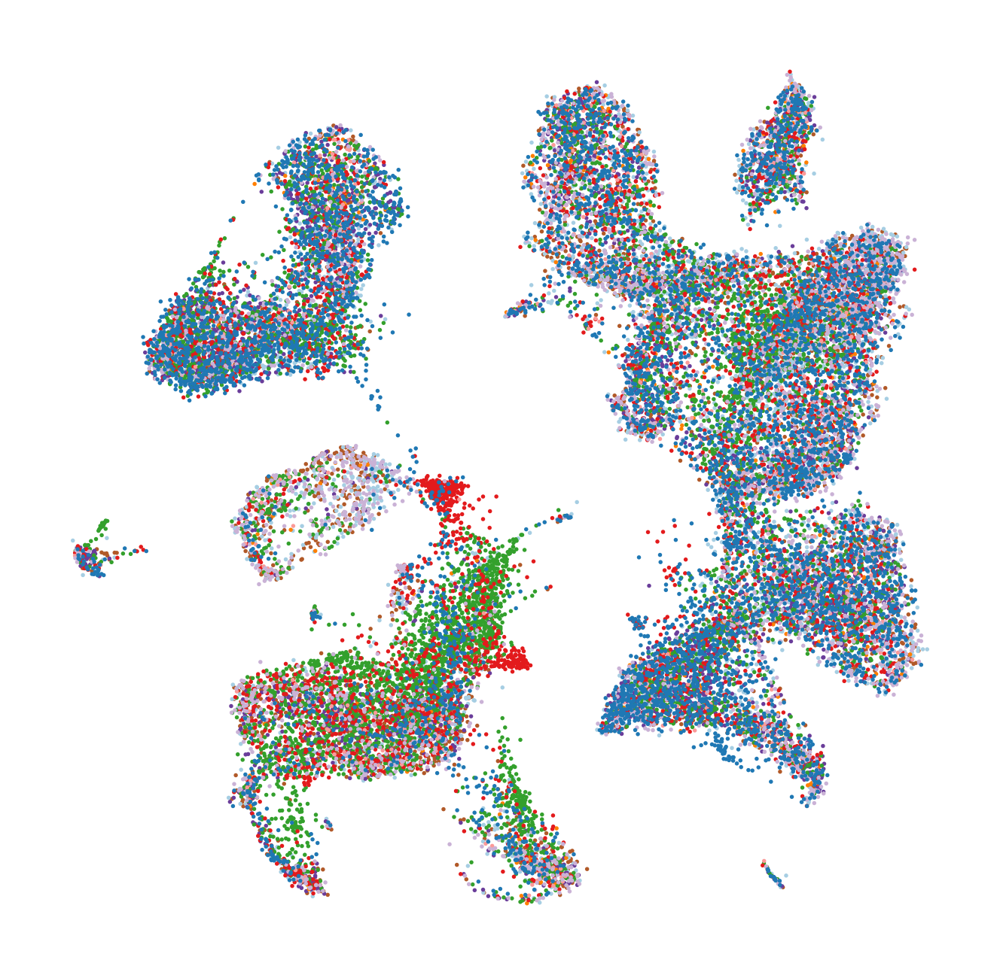

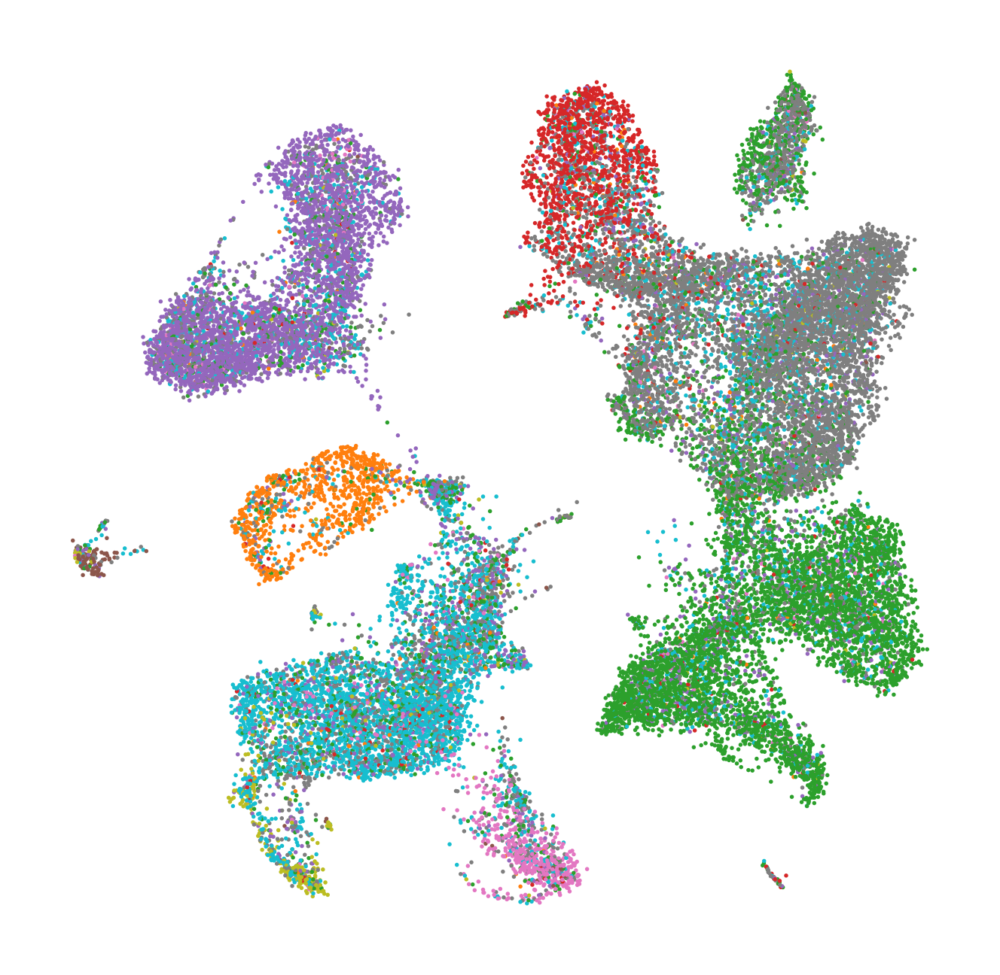

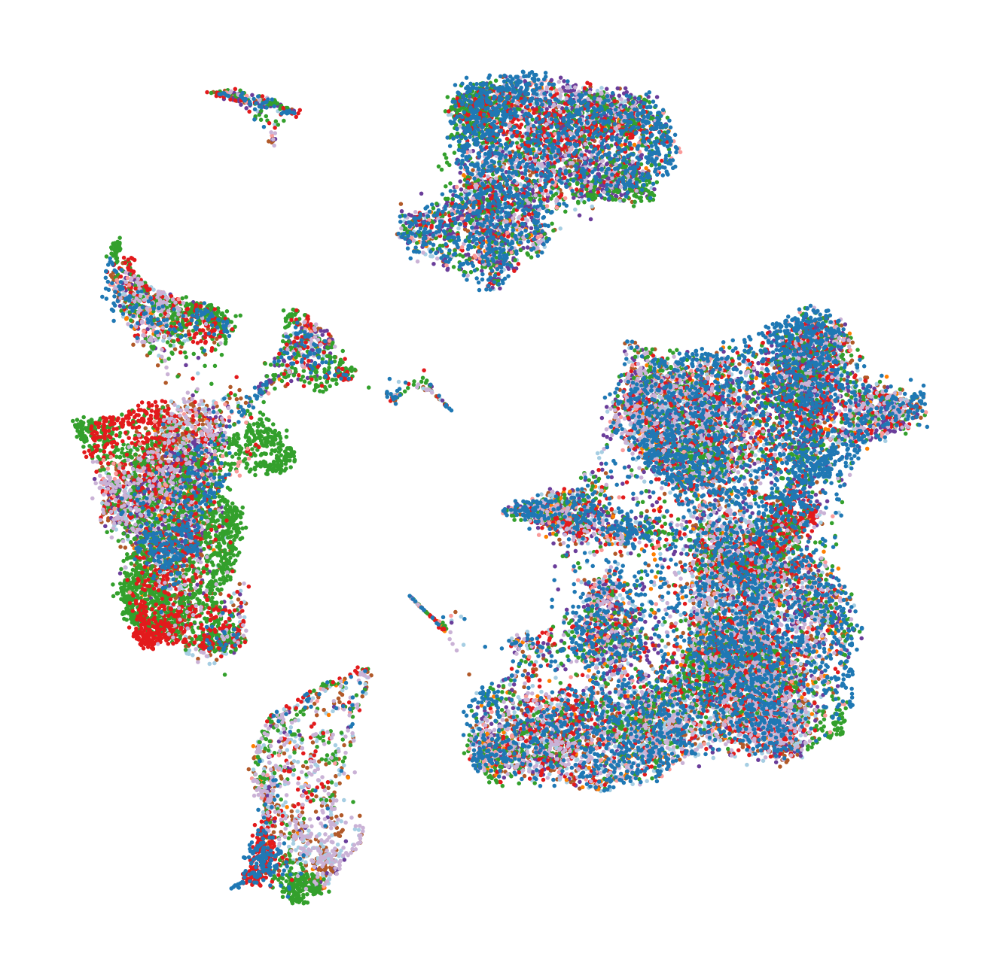

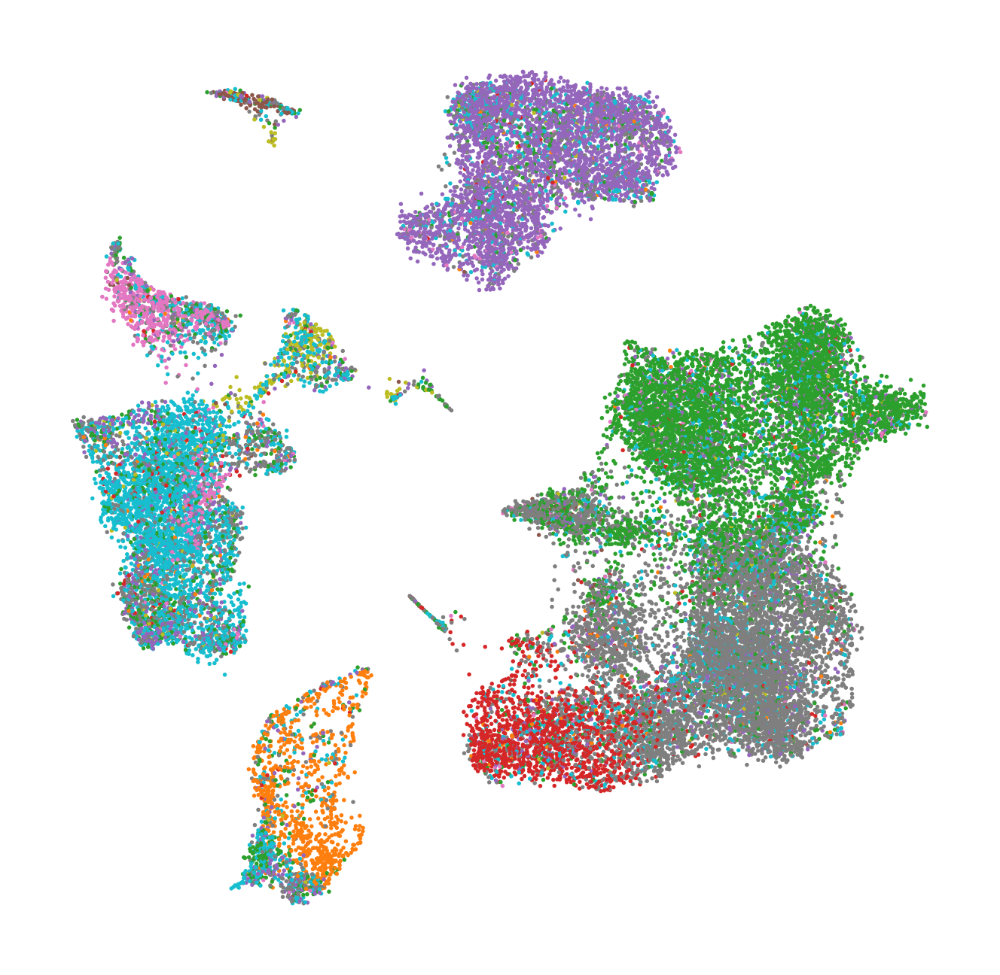

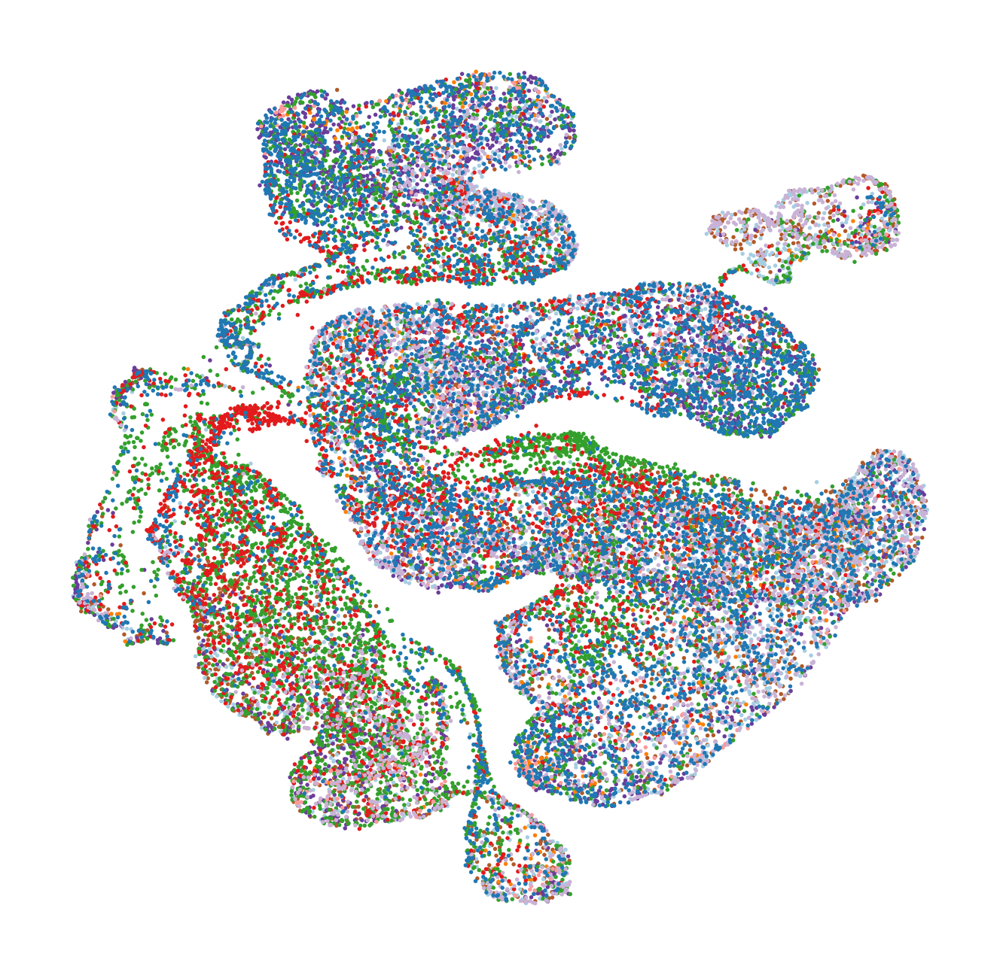

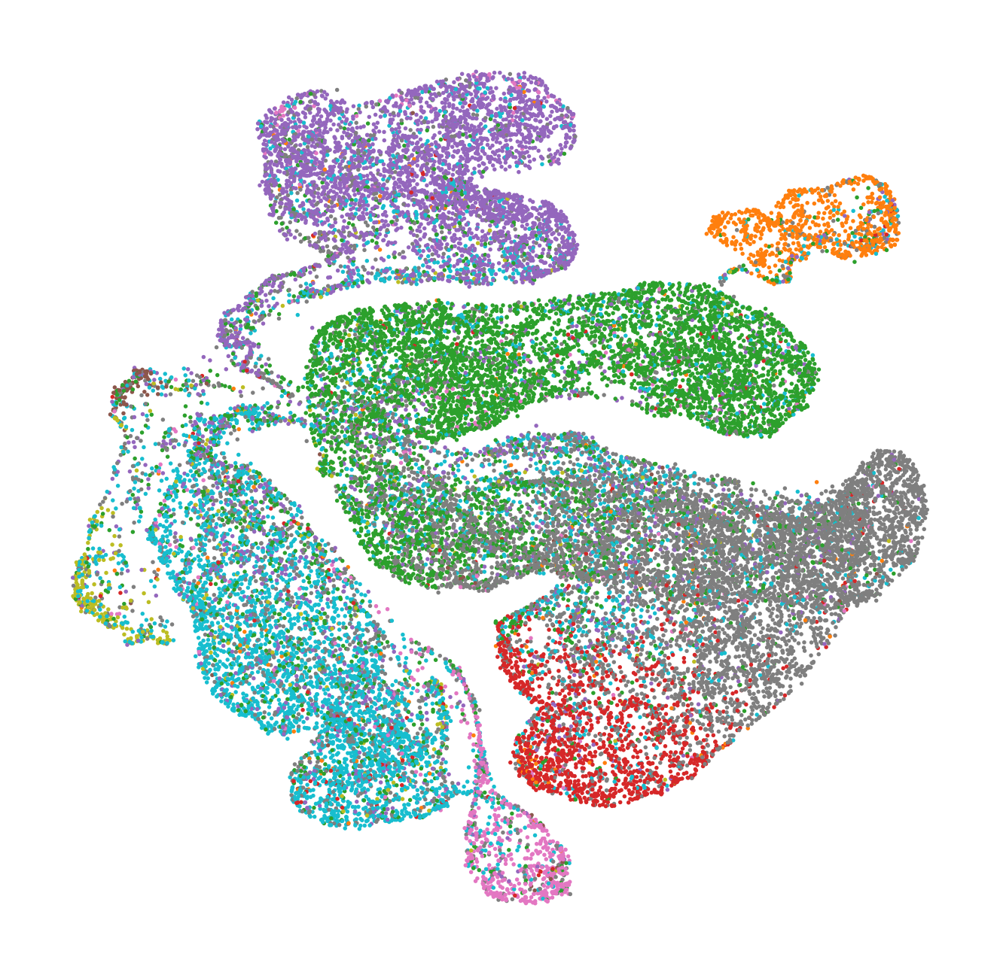

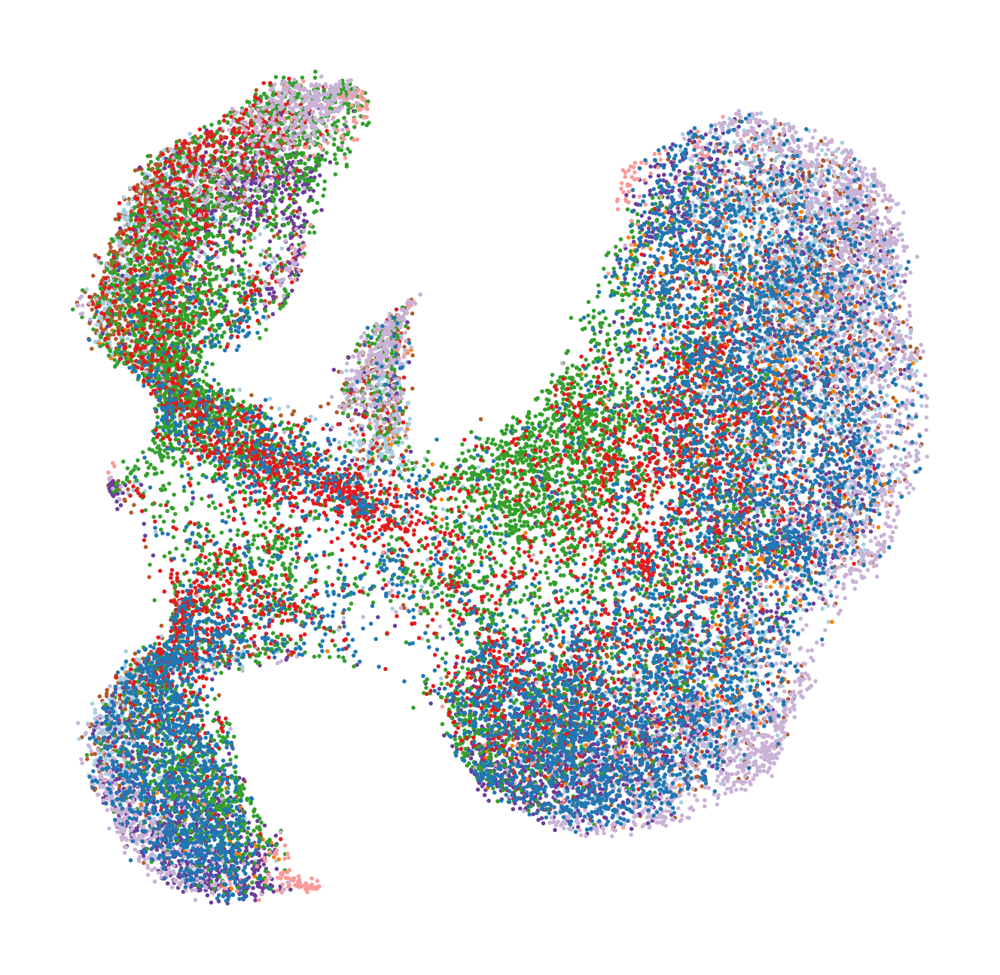

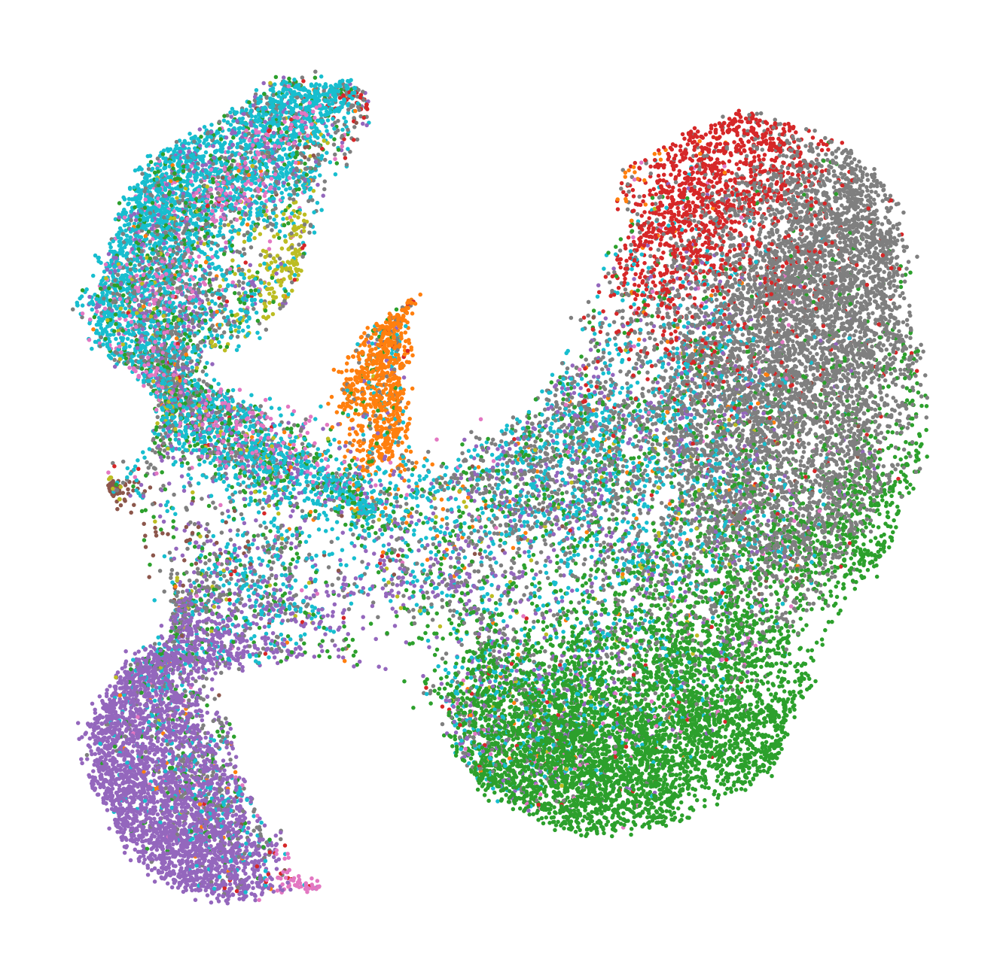

/homes/gws/ewein/miniconda3/envs/batch_effects/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


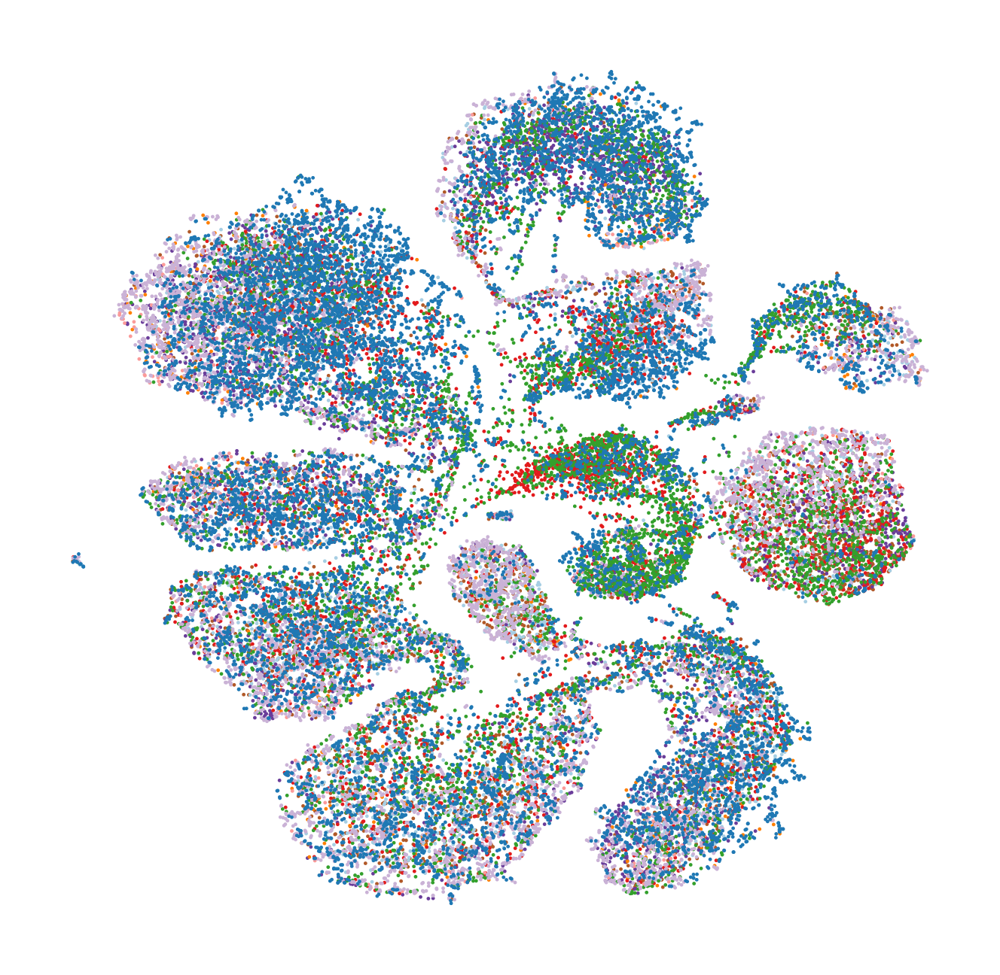

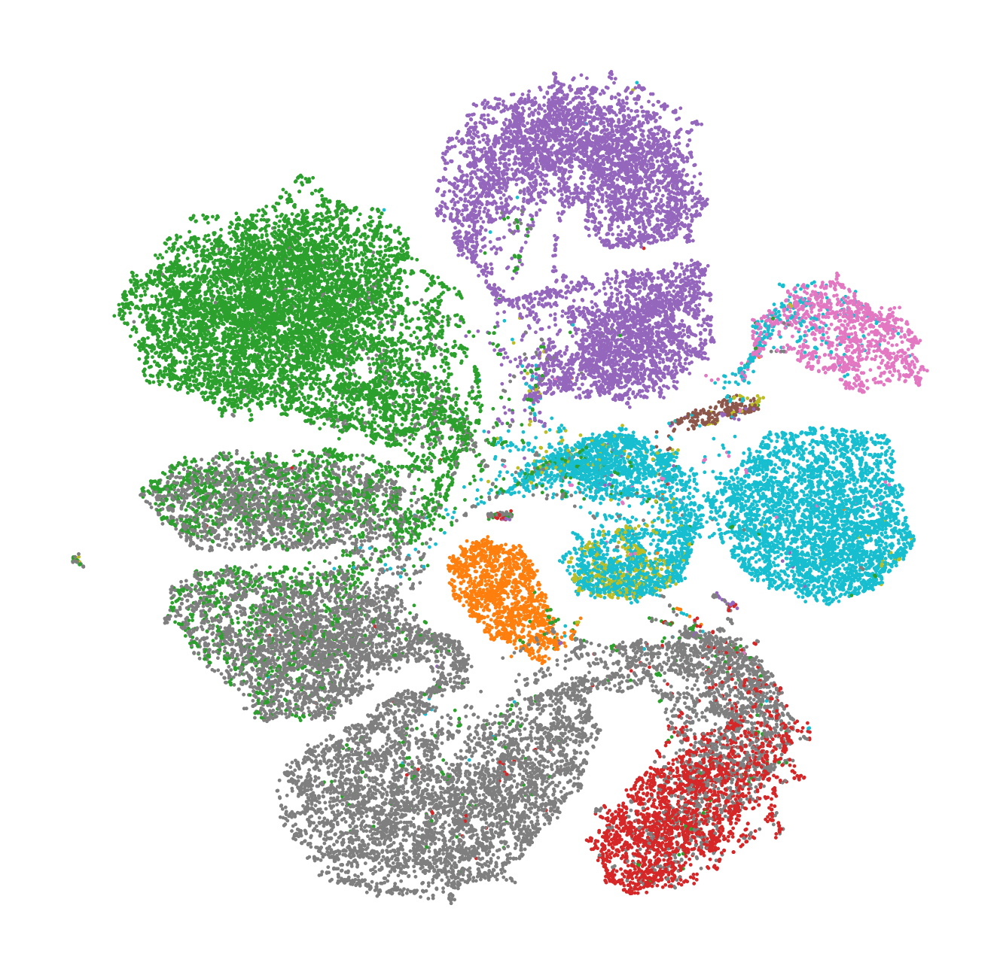

/homes/gws/ewein/miniconda3/envs/batch_effects/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


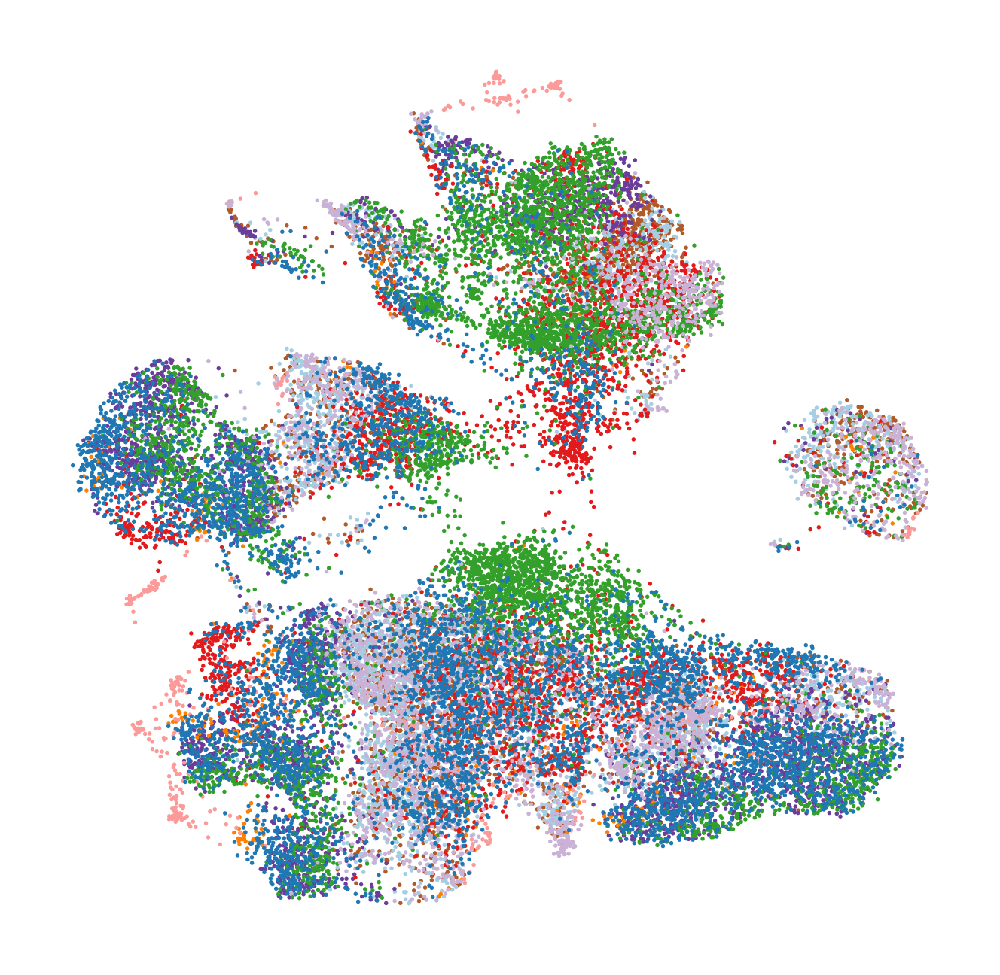

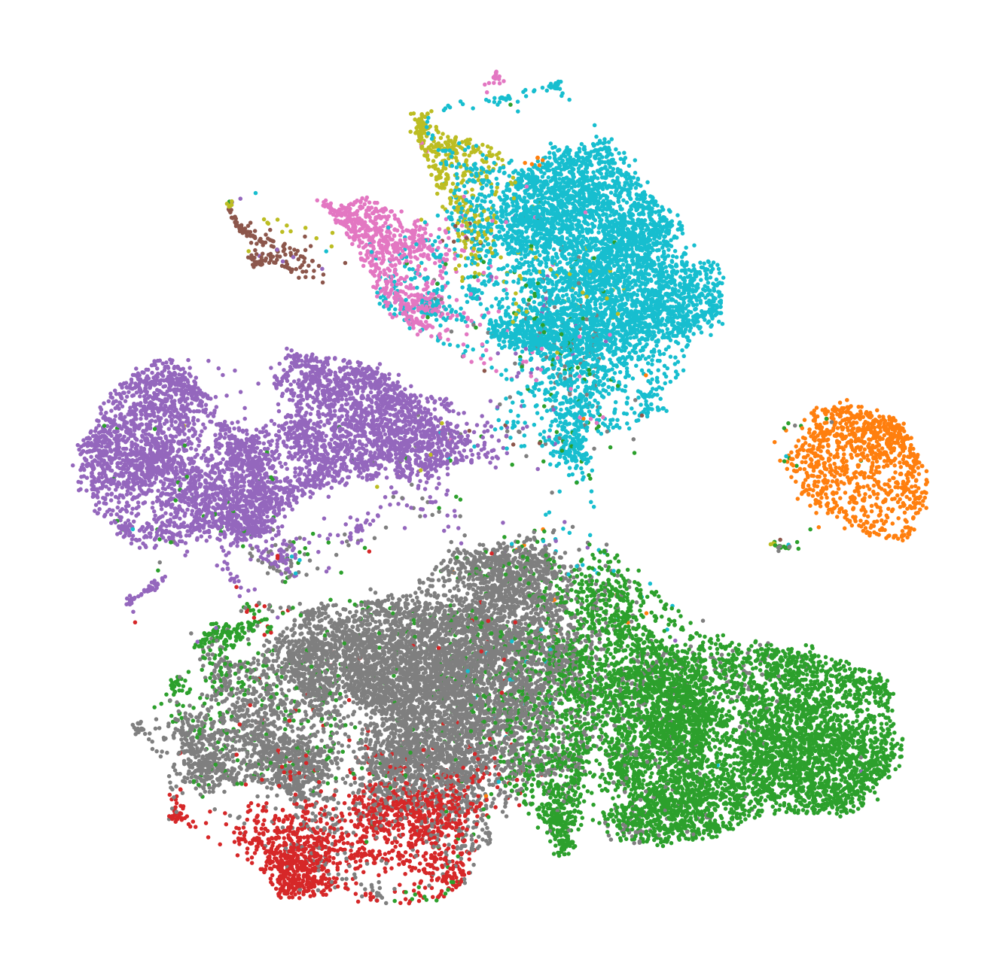

/homes/gws/ewein/miniconda3/envs/batch_effects/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


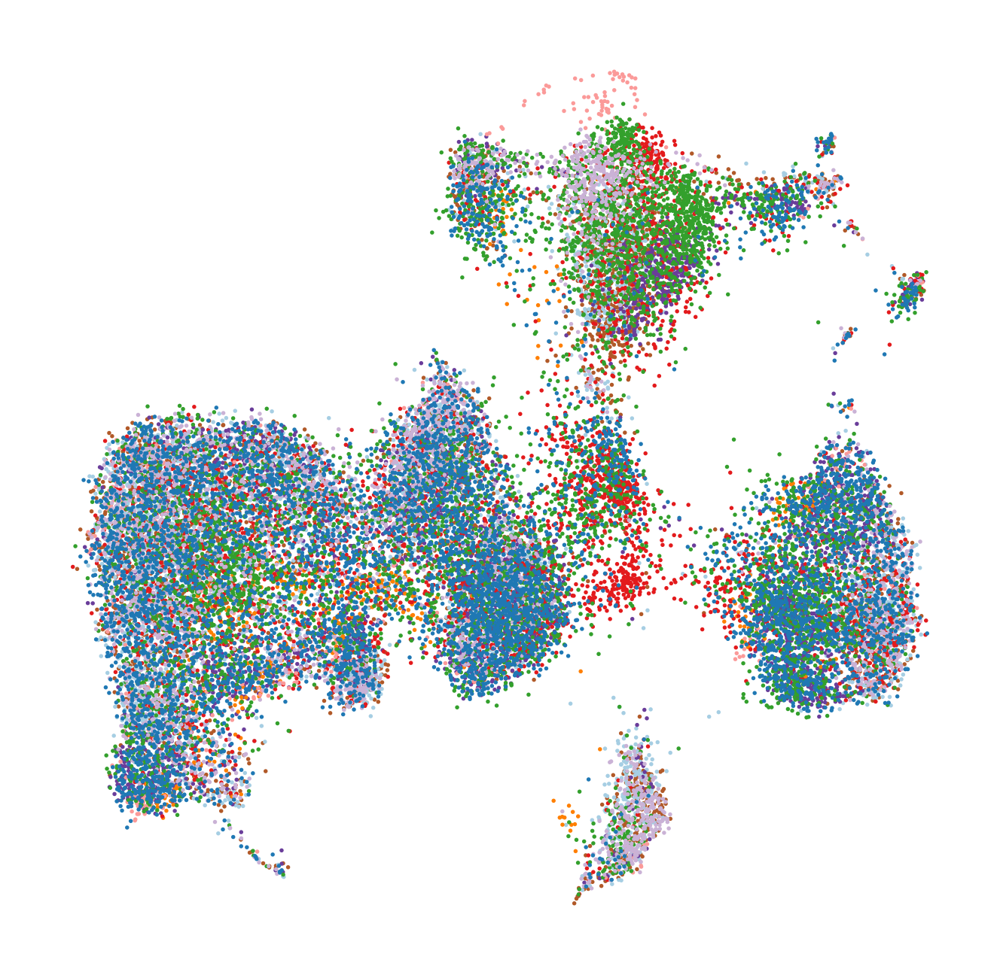

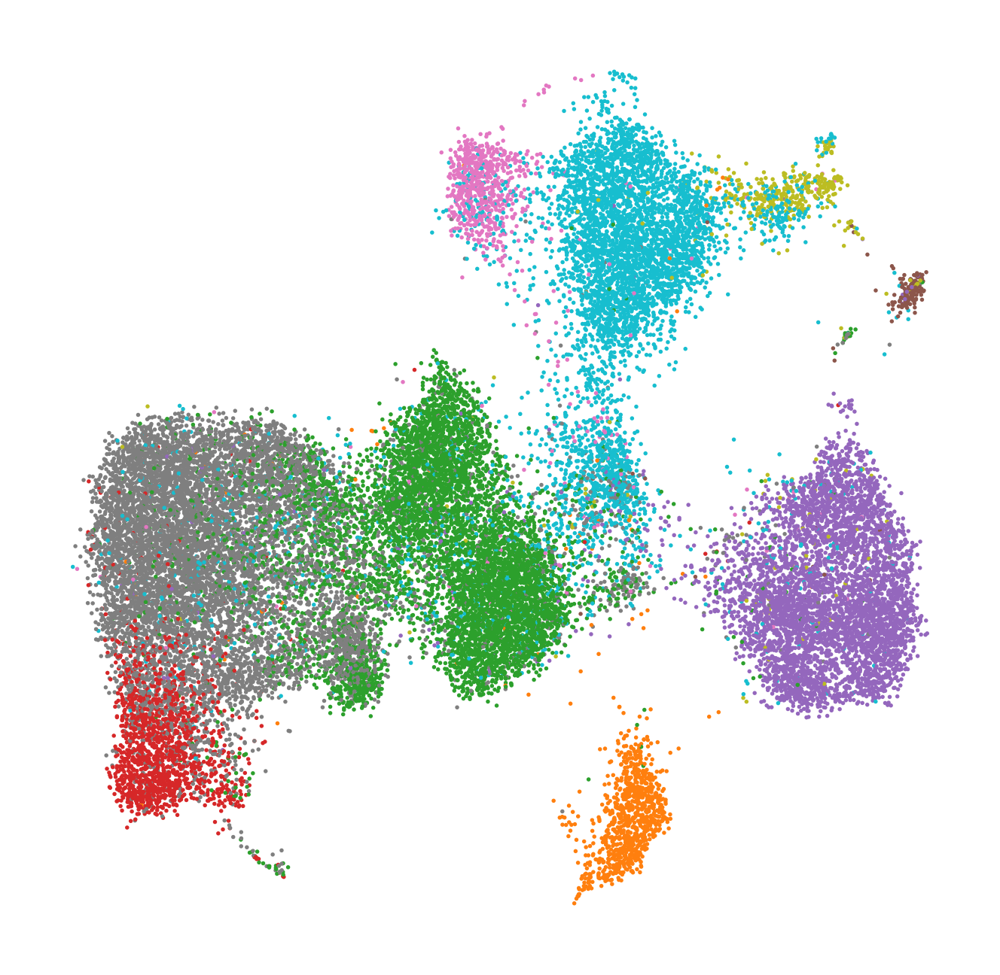

In [55]:
%matplotlib inline

methods = ["seurat", "harmony", "conos", 'scAlign', "desc", "scvi", "hd-md"]
#proper_names = ["MNN", "Seurat", "Harmony", "Conos", "DESC", "scVI", "HD-MD"]
#methods = ['hd-md']
#proper_names = ['scAlign']
from utils import set_seeds

for i, method in enumerate(methods):
    plot_results(method, dataset, ["study", "cell_type"], title="", legend_loc=False)

In [25]:
def plot_data(dataset, keys, title=None, frameon=False, legend_loc='right margin'):
    set_seeds()
    sc.set_figure_params(dpi=200)
    adata = load_data(dataset, normalized=True)

    adata.obs["cell_type"] = adata.obs["cell_type"].astype("category")
    adata.obs["study"] = adata.obs["study"].astype("category")

    study_cmap_map = study_cmaps[dataset]
    cell_cmap_map = cell_type_cmaps[dataset]

    adata.uns["study_colors"] = [study_cmap_map[study] for study in adata.obs["study"].cat.categories]
    adata.uns["cell_type_colors"] = [cell_cmap_map[cell_type] for cell_type in adata.obs["cell_type"].cat.categories]

    sc.pp.neighbors(adata)
    sc.tl.umap(adata, random_state=42)
    for key in keys:
        sc.pl.umap(adata, color=key, frameon=frameon, legend_loc=legend_loc, title=title)

         Falling back to preprocessing with `sc.pp.pca` and default params.


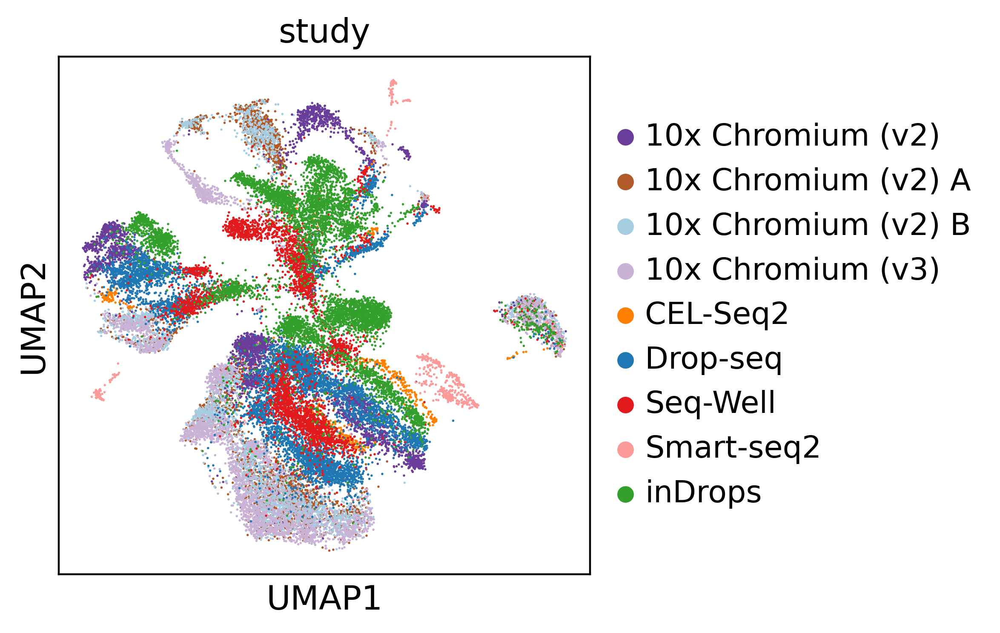

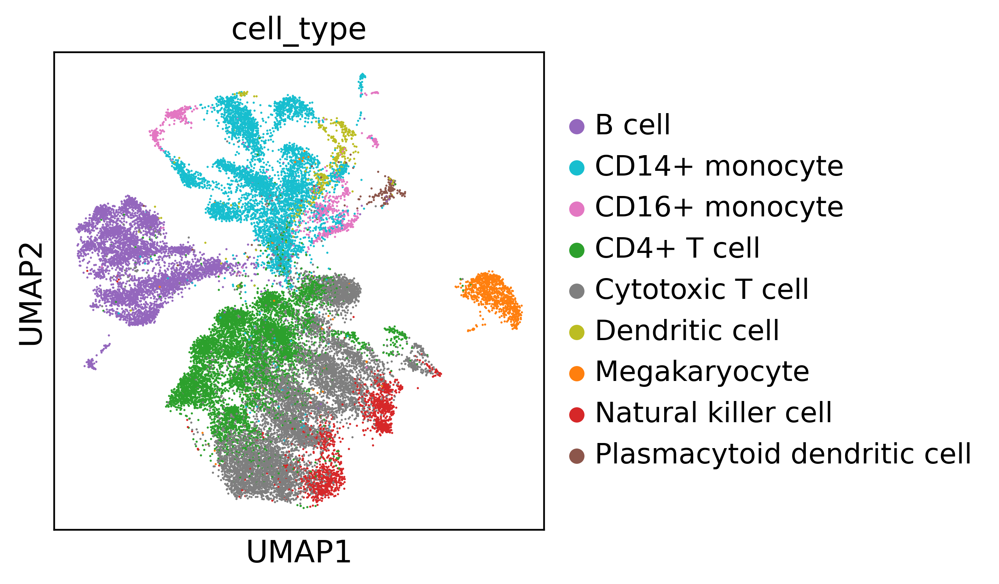

In [27]:
plot_data("pbmc_generalization", ["study", "cell_type"], frameon=True)

In [ ]:
import scanpy as sc
adata = load_results(...)
sc.pp.neighbors(adata)
sc.tl.umap(adata, random_state=42)
sc.pl.umap(adata, color='cell_type')

In [1]:
from utils import load_results

In [56]:
def plot_saucie(dataset, keys, frameon=False, title=None, legend_loc='right margin'):
    results_adata = load_results('saucie', dataset)
        
    set_seeds()
    sc.set_figure_params(dpi=200)

    study_cmap_map = study_cmaps[dataset]
    cell_cmap_map = cell_type_cmaps[dataset]
    
    if dataset == 'pbmc_generalization':
        tmp1 = results_adata[(results_adata.obs['study'] != '10x Chromium (v3)') & (results_adata.obs['study'] != 'Drop-seq')]
        tmp2 = results_adata[(results_adata.obs['study'] == '10x Chromium (v3)')]
        tmp3 = results_adata[(results_adata.obs['study'] == 'Drop-seq')]
        results_adata = AnnData.concatenate(tmp1, tmp2, tmp3)
    
    results_adata.obs["study"] = results_adata.obs["study"].astype("category")
    results_adata.obs["cell_type"] = results_adata.obs["cell_type"].astype("category")
    
    results_adata.uns["study_colors"] = [study_cmap_map[study] for study in results_adata.obs["study"].cat.categories]
    results_adata.uns["cell_type_colors"] = [cell_cmap_map[cell_type] for cell_type in
                                             results_adata.obs["cell_type"].cat.categories]
    
    results_adata.obsm['X_umap'] = results_adata.X

    for key in keys:
        sc.pl.umap(results_adata, color=key, frameon=frameon, legend_loc=legend_loc, title=title)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

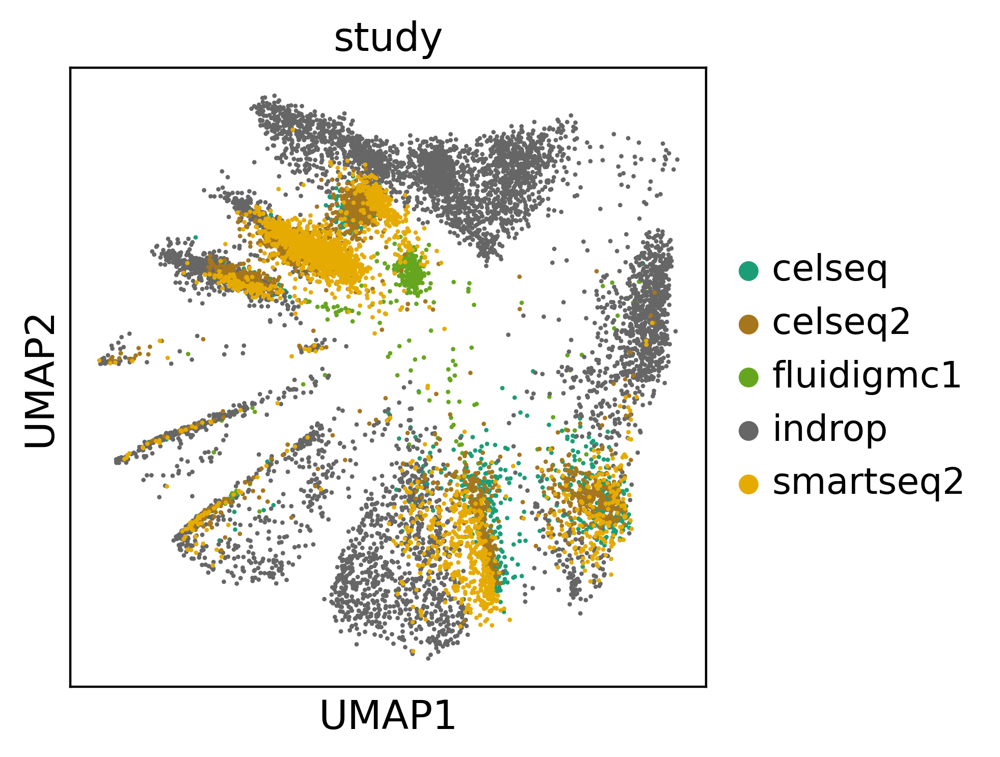

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

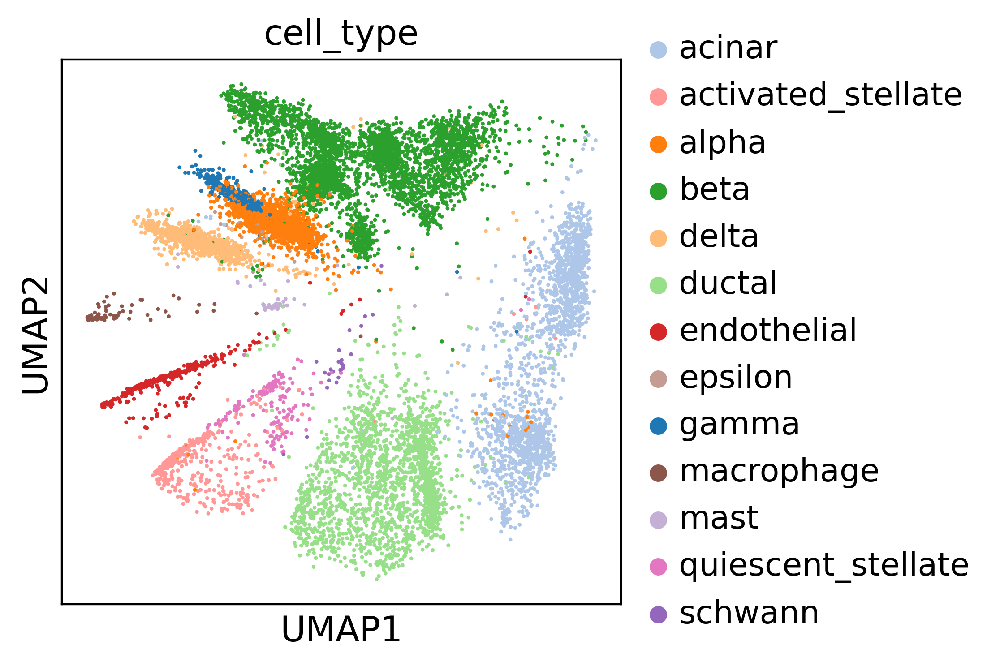

In [57]:
plot_saucie("pbmc_generalization", ["study", "cell_type"], frameon=True)

In [ ]:
plot_results(
    "hd-md_generalization", "pbmc_generalization",
    keys=['study', 'cell_type'], title="", frameon=False,
    legend_loc=False, batches_to_exclude = ["Drop-seq", "10x Chromium (v3)"])

In [16]:
results_adata = load_results('hd-md_generalization', 'pbmc_generalization', 0)

In [24]:
results_adata.obs['study'].cat.categories

Index(['10x Chromium (v2)', '10x Chromium (v2) A', '10x Chromium (v2) B',
       '10x Chromium (v3)', 'CEL-Seq2', 'Drop-seq', 'Seq-Well', 'Smart-seq2',
       'inDrops'],
      dtype='object')

0        10x Chromium (v2) A
1        10x Chromium (v2) A
2        10x Chromium (v2) A
3        10x Chromium (v2) A
4        10x Chromium (v2) A
                ...         
30970                inDrops
30971                inDrops
30972                inDrops
30973                inDrops
30974                inDrops
Name: study, Length: 30975, dtype: category
Categories (9, object): ['10x Chromium (v2)', '10x Chromium (v2) A', '10x Chromium (v2) B', 'CEL-Seq2', ..., 'Smart-seq2', 'inDrops', '10x Chromium (v3)', 'Drop-seq']